In [457]:
%load_ext autoreload
%autoreload 2

import sys
sys.path.append('../')
sys.path.append('../hovernet')
sys.path.append('../hedest')

import json
import os
import pickle
import torch
import scanpy as sc
import pandas as pd

PATH = '/home/luca/Documents/data/'

#'/cluster/CBIO/data1/lgortana/'
#'/home/luca/Documents/data/'

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


# Load data

In [458]:
#load adata
adata_name = 'Visium_FFPE_Human_Breast_Cancer'
data_path = os.path.join(PATH, adata_name)
path_ST_adata = os.path.join(data_path, "ST")
adata = sc.read_visium(path_ST_adata)

#load segmentation
json_path = os.path.join(data_path, "seg_json/pannuke_fast_mask_lvl3.json") #'/seg_json/consep_original_mask_lvl3_nolabel.json'
with open(json_path) as json_file:
    hovernet_dict = json.load(json_file)

#load spot proportions
spot_prop_df = pd.read_csv(os.path.join(data_path, f'props/DestVI_4000_hvg_squash_06_02_Visium_FFPE_Human_Breast_Cancer_prop.csv'), index_col=0)
spot_prop_df.index = spot_prop_df.index.astype(str)
ct_list = spot_prop_df.columns.tolist()

/home/luca/anaconda3/envs/plugin-env/lib/python3.9/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/luca/anaconda3/envs/plugin-env/lib/python3.9/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


In [459]:
#load images
image_path = os.path.join(data_path, "pyr_tif/Visium_FFPE_Human_Breast_Cancer_image.tif")
image_dict = torch.load(os.path.join(data_path, "image_dict_64.pt"))

In [460]:
#load model infos
model_dir = '../models/Breast_cancer_FFPE/DestVI_4000_hvg_squash_06_02/model_quick_alpha_0.0_lr_0.0003_divergence_l2_beta_0.0_seed_42/'

with open(os.path.join(model_dir, 'info.pickle'), 'rb') as f:
    model_info = pickle.load(f)

In [461]:
from hedest.analysis.pred_analyzer import PredAnalyzer

analyzer = PredAnalyzer(model_info=model_info)

Loading predicted labels...
Use `add_attributes(seg_dict=your_seg_dict)` to add one.


In [462]:
analyzer.add_attributes(image_dict=image_dict,
                        adata=adata,
                        adata_name=adata_name,
                        image_path=image_path,
                        seg_dict=hovernet_dict)

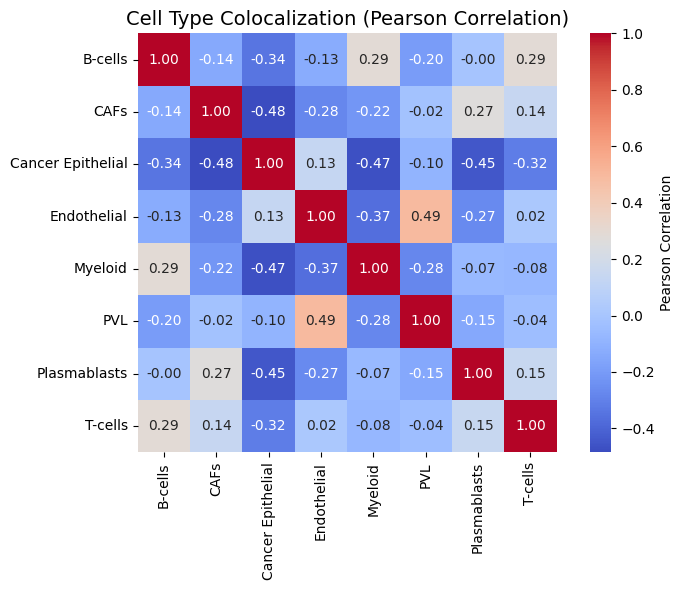

In [463]:
analyzer.plot_colocalization_matrix()

In [464]:
from hedest.analysis.postseg import StdVisualizer

color_dict = {
    '0': ['B-cells', [139, 69, 19, 255]],
    '1': ['CAFs', [255, 140, 0, 255]],
    '2': ['Cancer Epithelial', [31, 119, 180, 255]],
    '3': ['Endothelial', [230, 90, 60, 255]],
    '4': ['Myeloid', [0, 170, 140, 255]],
    '5': ['PVL', [255, 220, 100, 255]],
    '6': ['Plasmablasts', [128, 0, 128, 255]],
    '7': ['T-cells', [0, 150, 0, 255]]
}

analyzer.color_dict = color_dict
plotter = StdVisualizer(image_path, 
                        adata, 
                        adata_name, 
                        seg_dict=analyzer.seg_dict_w_class,
                        color_dict=color_dict)

Visium data found.


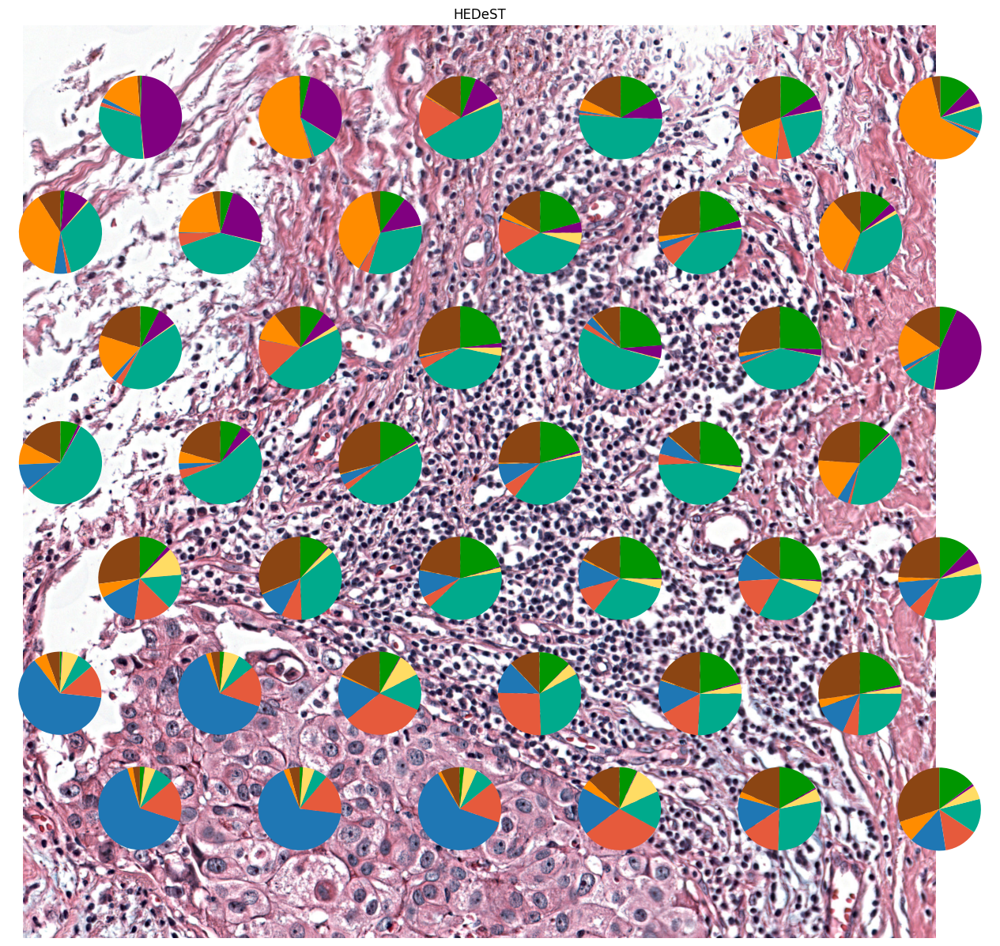

In [480]:
window = ((6500, 10500), (2000, 2000))
plotter.plot_slide(window, title="HEDeST", spot_prop_df=spot_prop_df, show_visium=True)

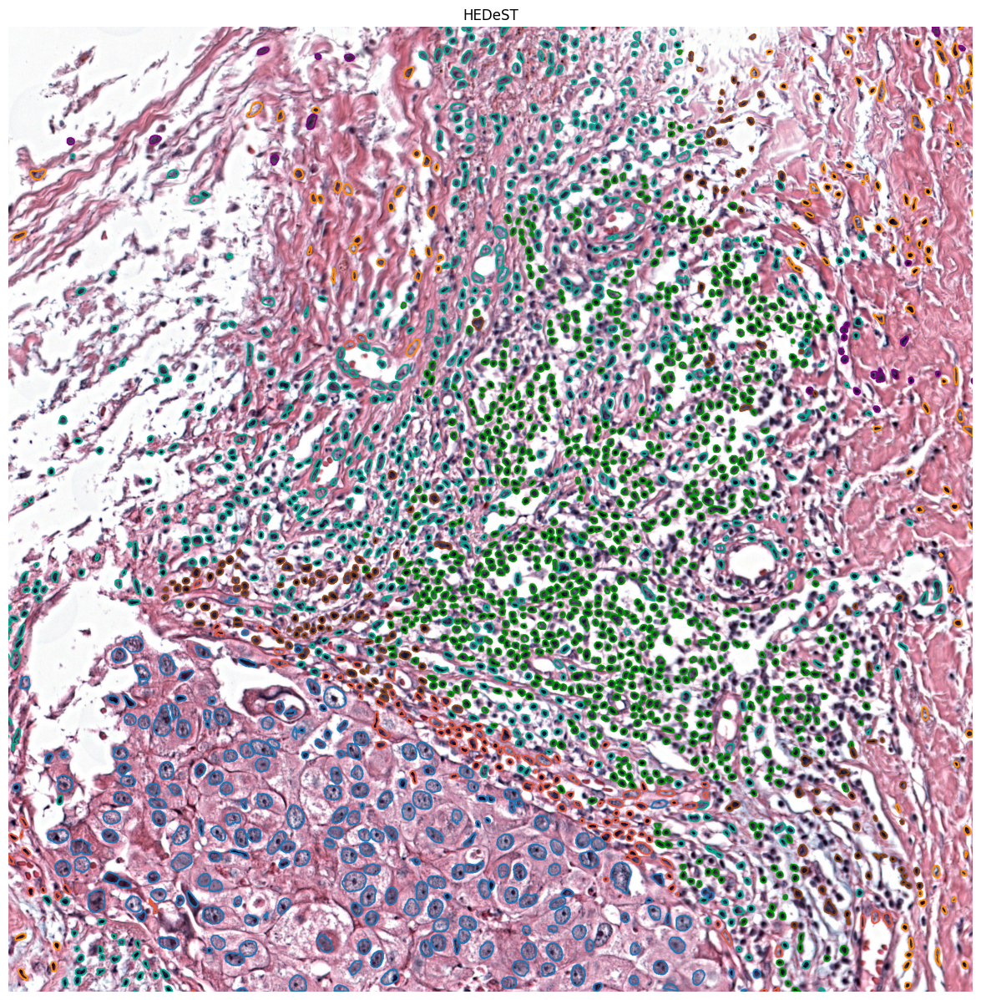

In [481]:
plotter.plot_seg(window, title="HEDeST", show_visium=False)

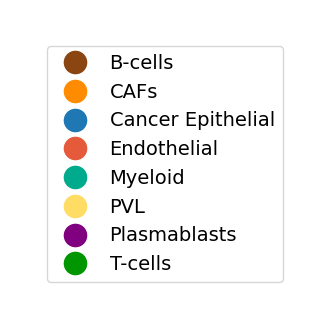

In [439]:
from hedest.analysis.plots import plot_legend

plot_legend(color_dict)

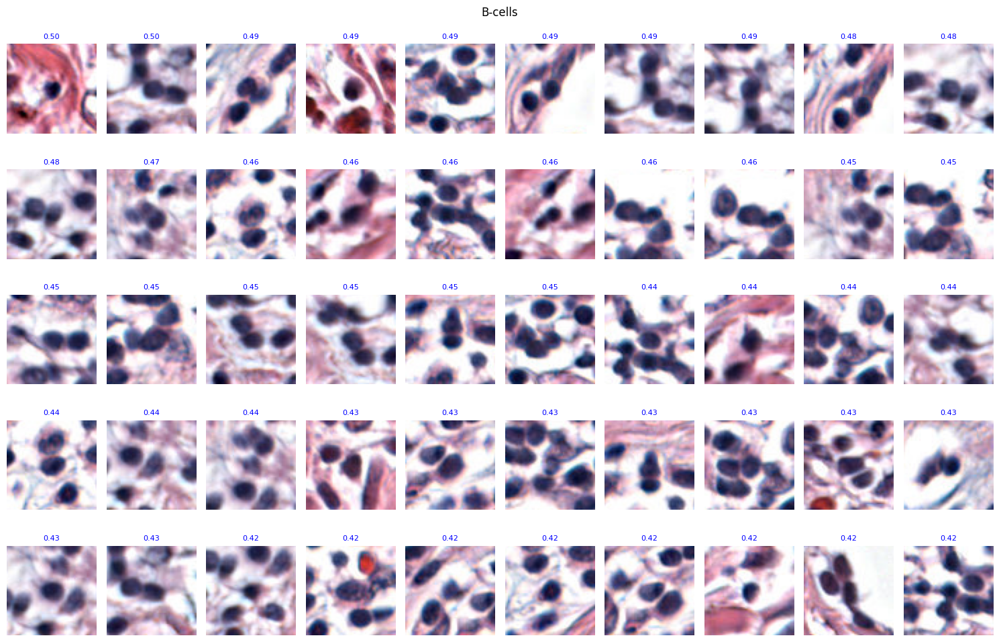

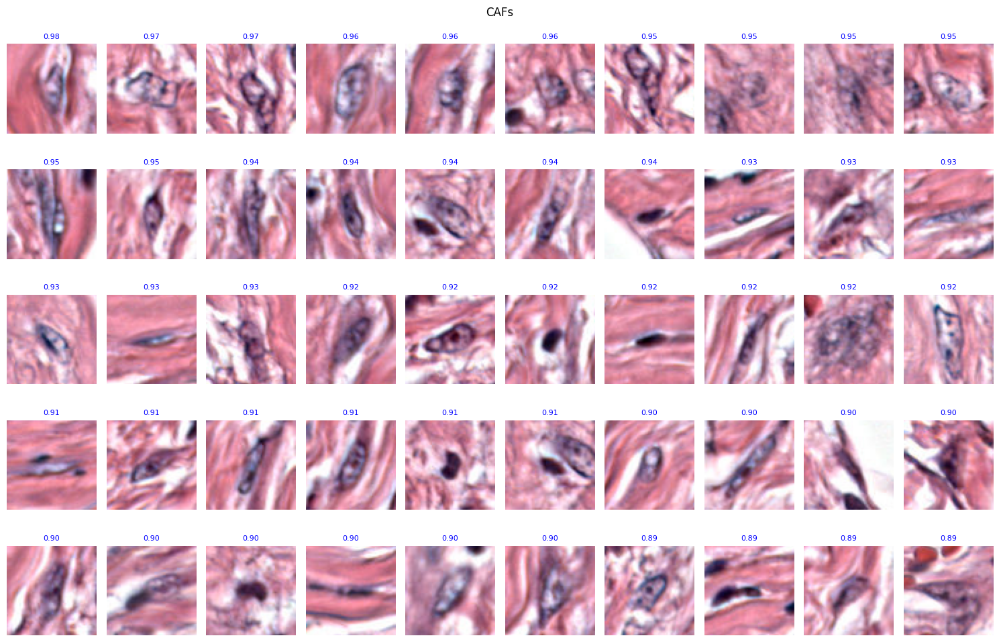

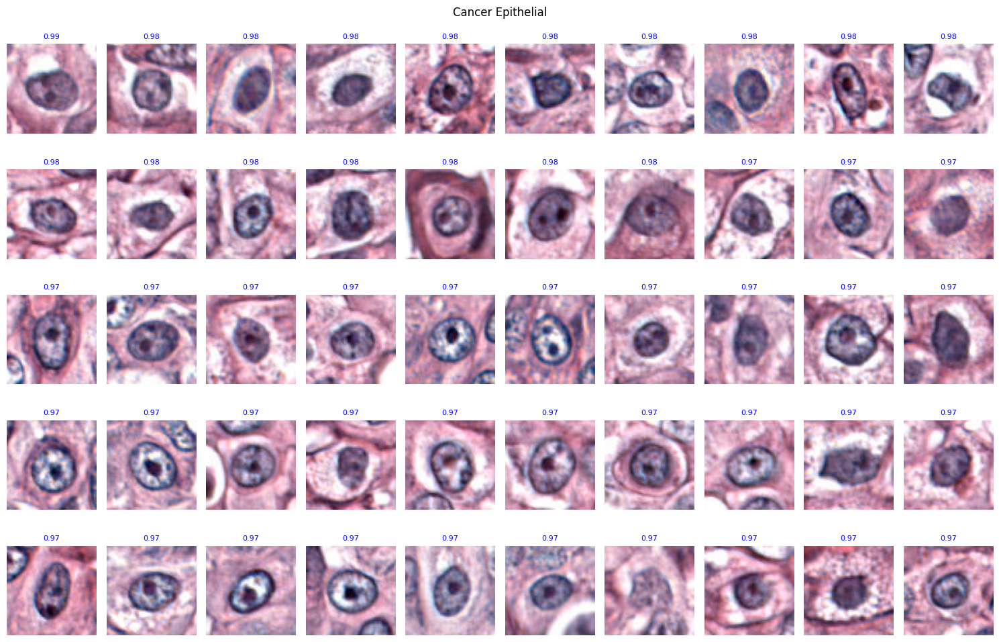

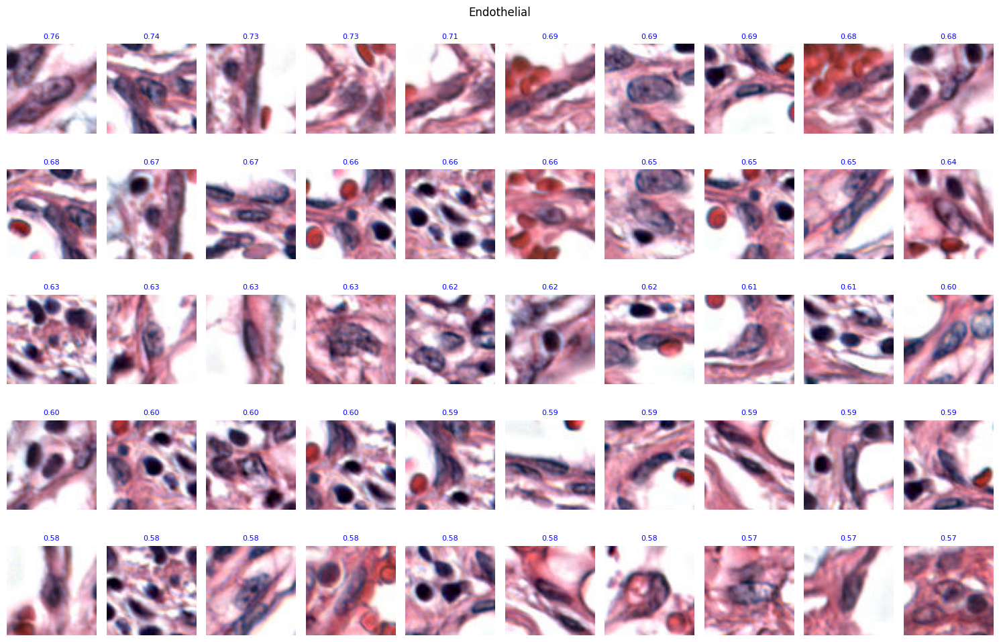

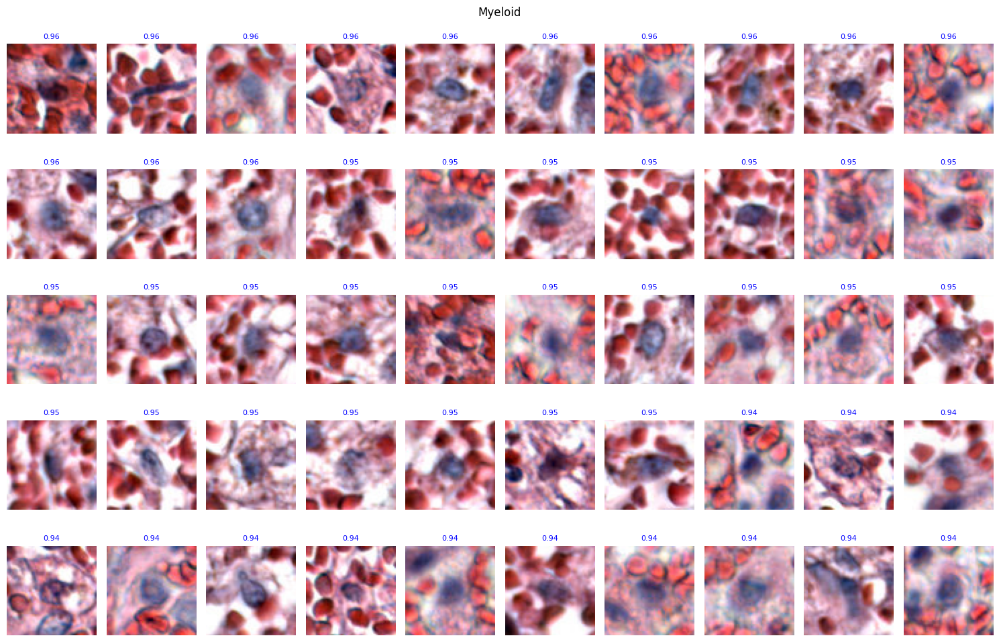

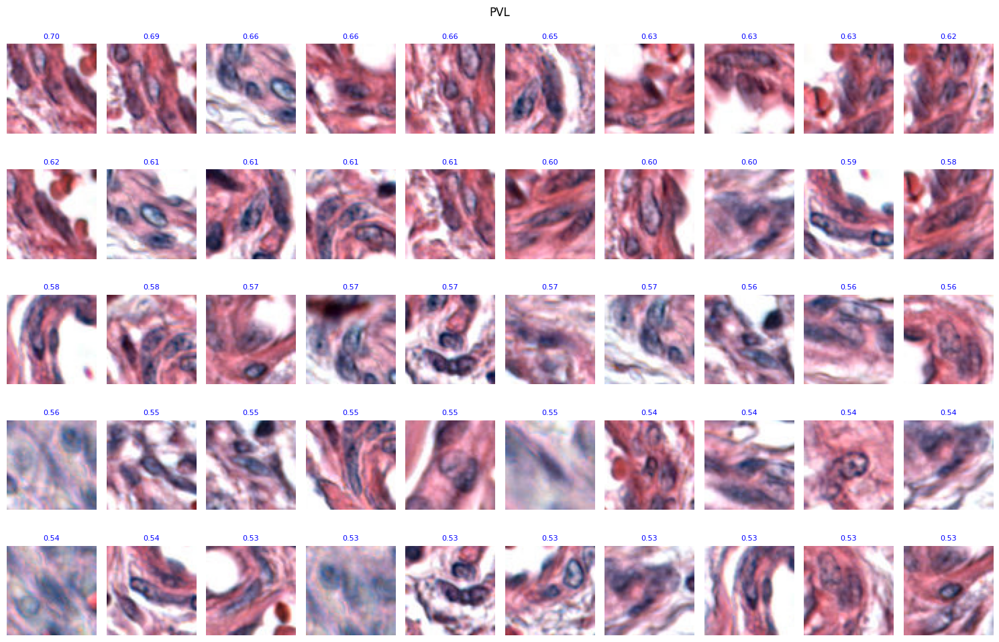

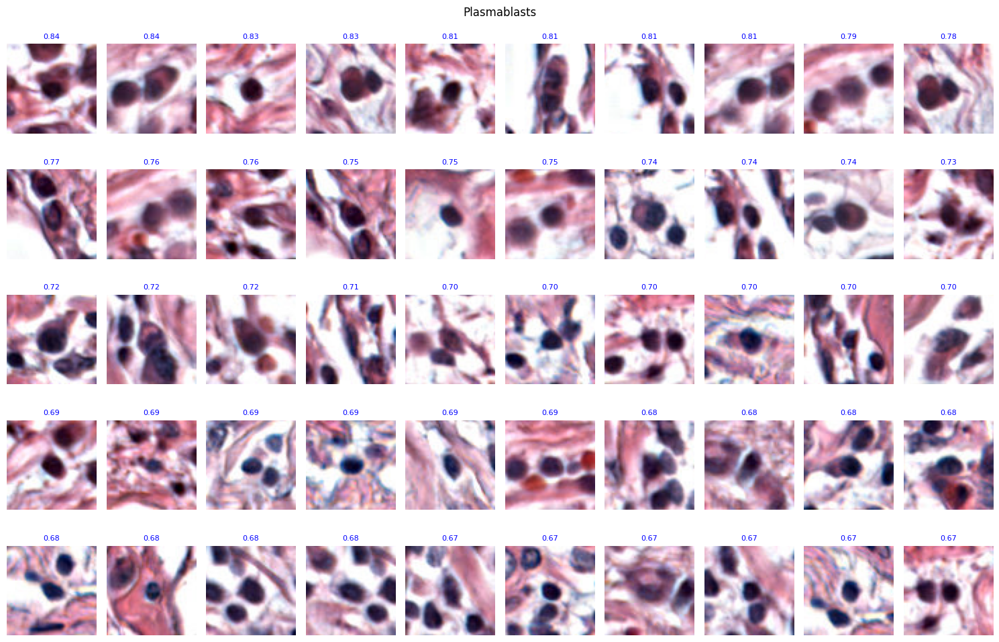

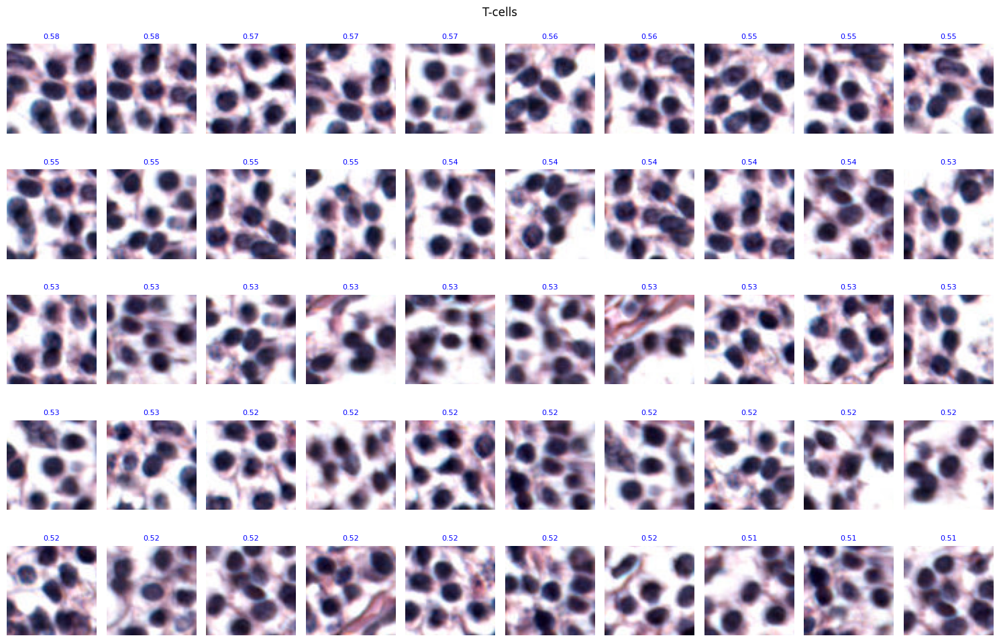

In [440]:
for ct in analyzer.ct_list:
    analyzer.plot_grid_celltype(cell_type=ct, n=50, selection="max", display=True)

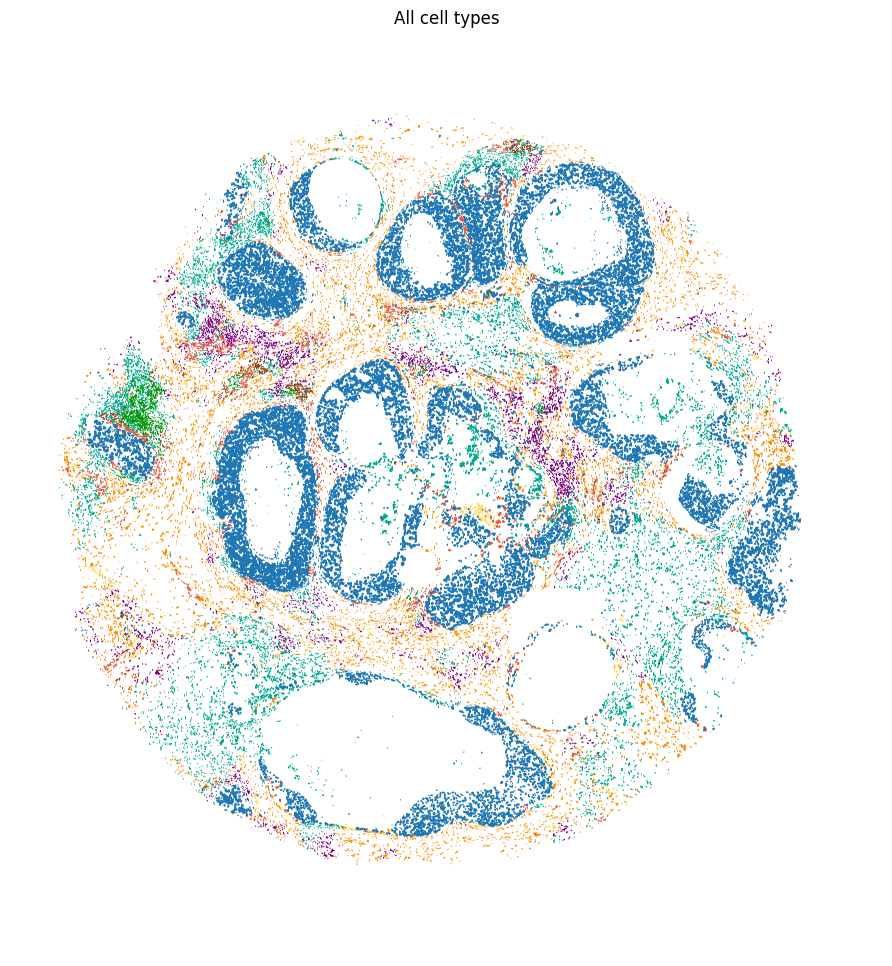

In [ ]:
window = ((4900, 3400), (18800, 19900))
plotter.plot_seg_overlays(window, separated=False, scale_cells=2)

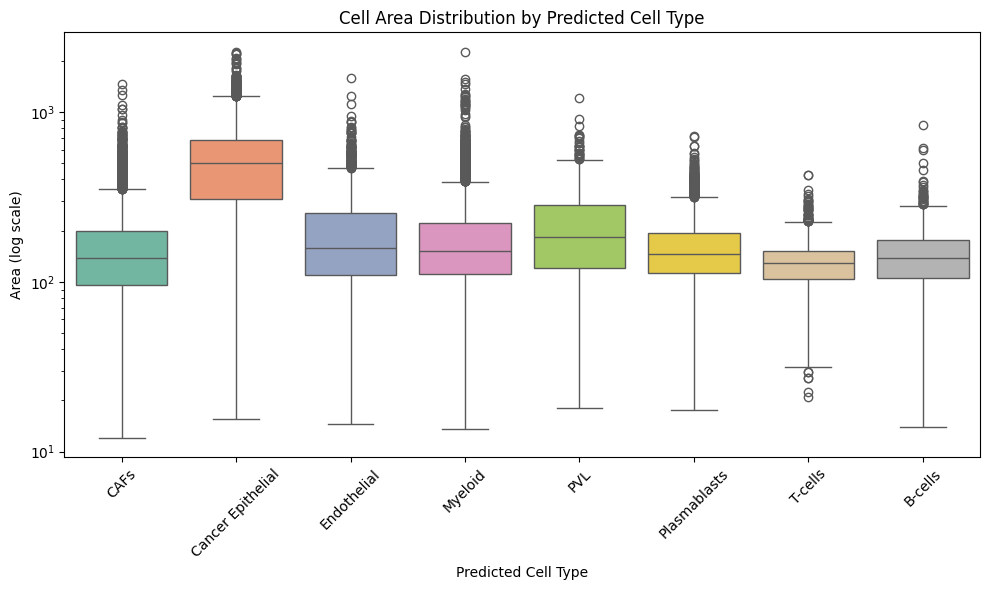

In [446]:
analyzer.compare_area(cell_types=ct_list[1:]+ ['B-cells'])

In [450]:
from scipy.stats import mannwhitneyu
from hedest.analysis.plots import polygon_area
import numpy as np

cell_type_a = "B-cells"
cell_type_b = "T-cells"

def p_to_star(p):
    if p <= 0.001:
        return '***'
    elif p <= 0.01:
        return '**'
    elif p <= 0.05:
        return '*'
    else:
        return 'ns'

areas_a = []
areas_b = []

for cell_id, info in analyzer.seg_dict_w_class["nuc"].items():
    cell_label = analyzer.predicted_labels.get(cell_id, {}).get("cell_type", None)
    contour = info.get("contour")
    if contour and len(contour) >= 3:
        area = polygon_area(contour)
        if cell_label == cell_type_a:
            areas_a.append(area)
        elif cell_label == cell_type_b:
            areas_b.append(area)

areas_a = np.array(areas_a)
areas_b = np.array(areas_b)

statistic, p_value = mannwhitneyu(areas_a, areas_b, alternative="greater")

print(f"U statistic: {statistic:.3f}")
print(f"One-sided p-value ({cell_type_a} > {cell_type_b}): {p_value:.4e} ({p_to_star(p_value)})")

U statistic: 586764.000
One-sided p-value (B-cells > T-cells): 9.6206e-09 (***)


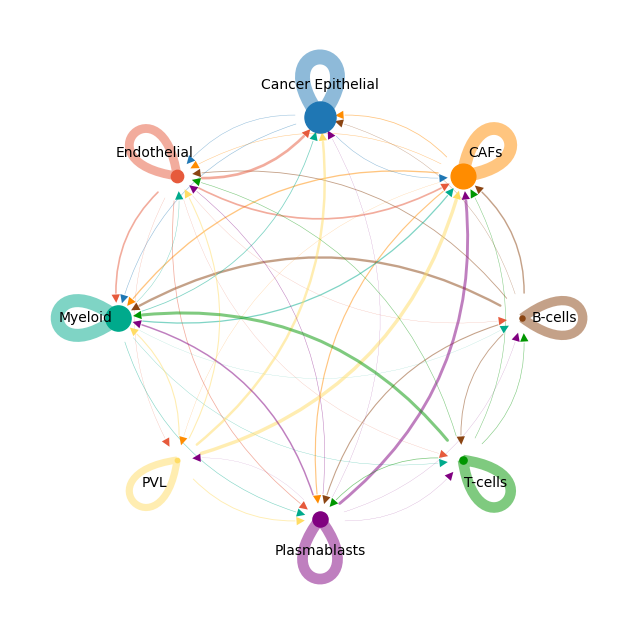

In [456]:
analyzer.compute_neighborhood_composition(max_distance=None)
analyzer.plot_colocalization_graph()

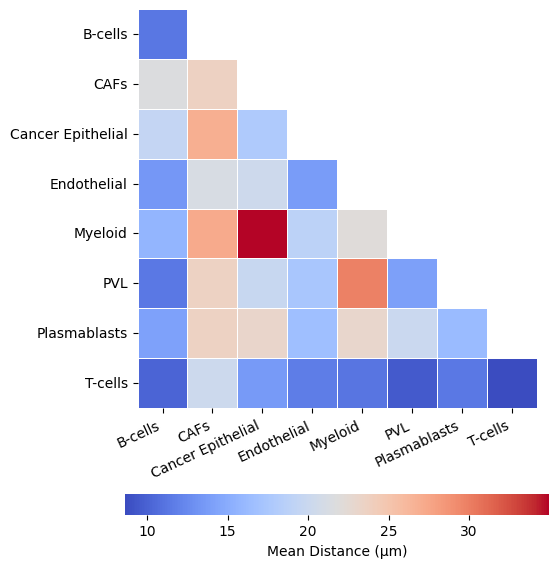

In [445]:
mean_distance = analyzer.plot_mean_neighbor_distances()

Visium data found.


TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.


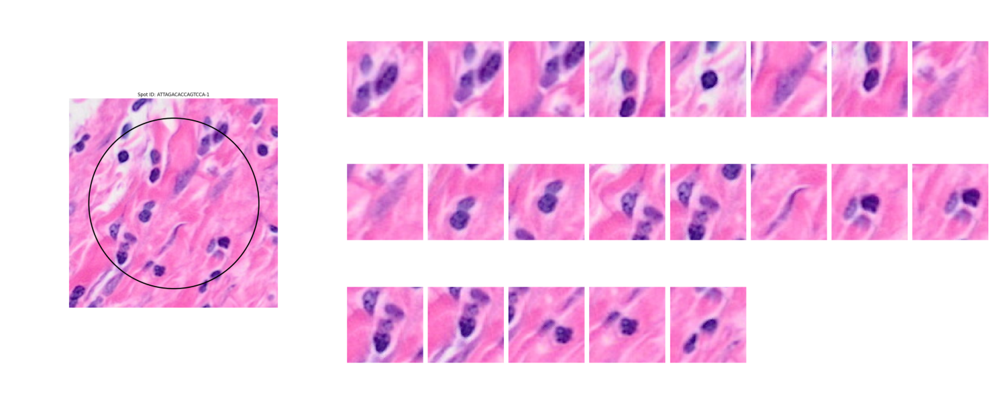

In [ ]:
analyzer.plot_predicted_cell_labels_in_spot(spot_id="ATTAGACACCAGTCCA-1", show_labels=False, display=True)

Randomly selected spot_id: AACTTCGTTAGCCGCT-1
Visium data found.


TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.


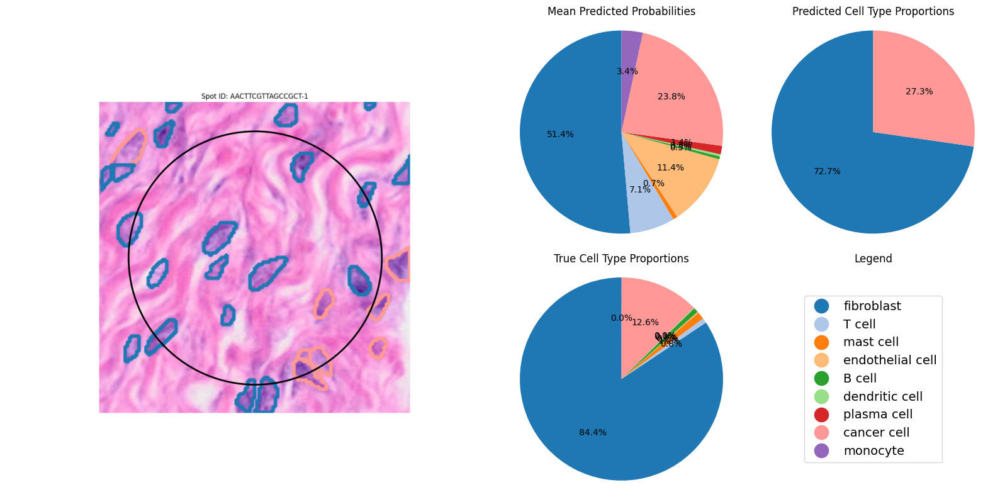

In [ ]:
analyzer.plot_spot_proportions(spot_id=None, draw_seg=True) #"ATTAGACACCAGTCCA-1"

In [ ]:
analyzer_adj = PredAnalyzer(model_info=model_info, adjusted=True)
analyzer_adj.add_attributes(image_dict=image_dict,
                        adata=adata,
                        adata_name=adata_name,
                        image_path=image_path,
                        seg_dict=hovernet_dict)

Loading predicted labels...
-> ok
Use `add_attributes(history=your_history)` to add one.
Use `add_attributes(seg_dict=your_seg_dict)` to add one.


Visium data found.


TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.


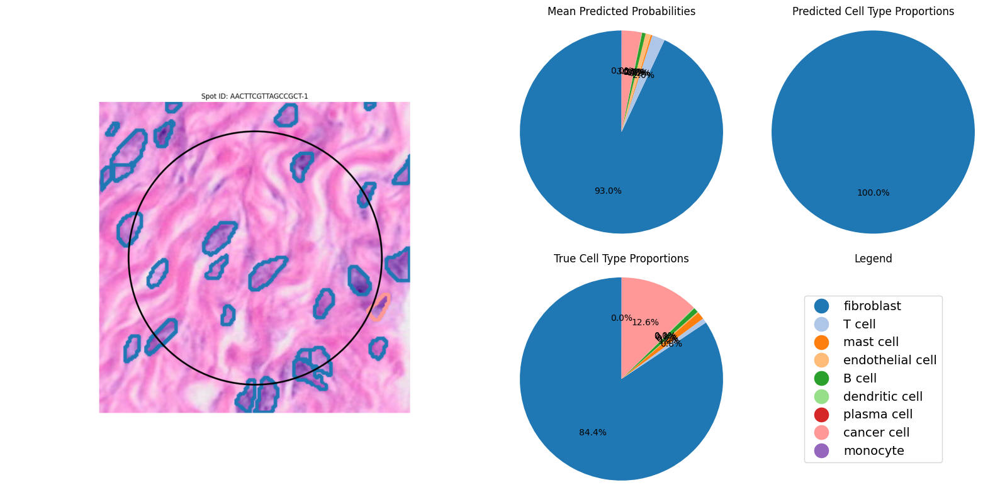

In [ ]:
analyzer_adj.plot_spot_proportions(spot_id="AACTTCGTTAGCCGCT-1", draw_seg=True)

# Plot legends

In [ ]:
# def plot_legend(dict_colors, ax=None, marker="o", markersize=18, fontsize=14, loc="center", bbox_to_anchor=None):
#     """
#     Plot a legend with an optional axis. If `ax` is None, a new figure is created for the legend.

#     Parameters:
#         dict_colors (dict): Dictionary where keys are identifiers, and values are [label, RGB color].
#         ax (matplotlib.axes._axes.Axes, optional): Axis to add the legend to. If None, a new figure is created.
#         marker (str): Marker style for legend items. Default is "o".
#         markersize (int): Size of the marker in the legend. Default is 18.
#         fontsize (int): Font size of the legend labels. Default is 14.
#         loc (str): Location of the legend (e.g., "upper right", "center"). Default is "center".
#         bbox_to_anchor (tuple, optional): Coordinates to fine-tune the legend position. Default is None.
#     """
#     # Extract labels and colors
#     legend_labels = [v[0] for v in dict_colors.values()]  # Extract labels
#     legend_colors = [tuple(c / 255 for c in v[1]) for v in dict_colors.values()]  # Normalize RGB to [0, 1]

#     # Create patches for the legend
#     patches = [
#         plt.Line2D([0], [0], marker=marker, color="w", markerfacecolor=color, markersize=markersize)
#         for color in legend_colors
#     ]

#     # If no axis is provided, create a new figure with an axis
#     if ax is None:
#         fig, ax = plt.subplots(figsize=(4, 4))  # Adjust `figsize` as needed
#         ax.axis("off")  # Disable the axis for a clean legend-only display

#     # Add the legend to the axis
#     ax.legend(
#         patches,
#         legend_labels,
#         loc=loc,
#         fontsize=fontsize,
#         bbox_to_anchor=bbox_to_anchor
#     )

#     # If no axis was provided, show the new figure
#     if ax is None:
#         plt.show()

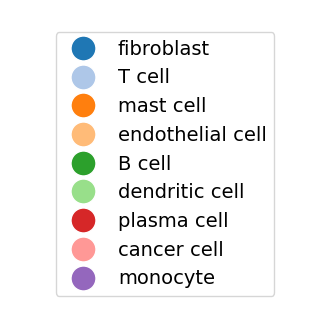

In [ ]:
from hedest.plots import plot_legend
plot_legend(color_dict=analyzer.color_dict)

# Summary metrics

In [ ]:
import pandas as pd
metrics = pd.read_csv('summary_metrics_l2_final.csv')
metrics_adj = pd.read_csv('summary_metrics_l2_final_adj.csv')

In [ ]:
from hedest.gridsearch import evaluate_performance

perf = evaluate_performance(table = metrics, 
                     feature_a = ["lr", "weights"], 
                     feature_b = ["alpha"],
                     metric = "Spearman Correlation")

perf_adj = evaluate_performance(table = metrics_adj,
                        feature_a = ["lr", "weights"], 
                        feature_b = ["alpha"],
                        metric = "Spearman Correlation")

perf2 = evaluate_performance(table = metrics, 
                     feature_a = ["lr", "weights"], 
                     feature_b = ["alpha"],
                     metric = "Pearson Correlation")

perf_adj2 = evaluate_performance(table = metrics_adj,
                        feature_a = ["lr", "weights"], 
                        feature_b = ["alpha"],
                        metric = "Pearson Correlation")

perf3 = evaluate_performance(table = metrics, 
                     feature_a = ["lr", "weights"], 
                     feature_b = ["alpha"],
                     metric = "MSE")

perf_adj3 = evaluate_performance(table = metrics_adj,
                        feature_a = ["lr", "weights"], 
                        feature_b = ["alpha"],
                        metric = "MSE")

perf4 = evaluate_performance(table = metrics, 
                     feature_a = ["lr", "weights"], 
                     feature_b = ["alpha"],
                     metric = "Weighted Precision")

perf_adj4 = evaluate_performance(table = metrics_adj,
                        feature_a = ["lr", "weights"], 
                        feature_b = ["alpha"],
                        metric = "Weighted Precision")

In [ ]:
perf

alpha                 0.0       0.2       0.3       0.5
lr      weights                                        
0.00001 False    0.540952  0.286527  0.049533  0.067058
        True     0.591948 -0.099490 -0.096439 -0.101102
0.00010 False    0.659012  0.337083  0.256944  0.313238
        True     0.671260 -0.064516 -0.065055 -0.055155

In [ ]:
perf[perf.columns[0]].values[2]

0.6590121040805972

## Classic histograms

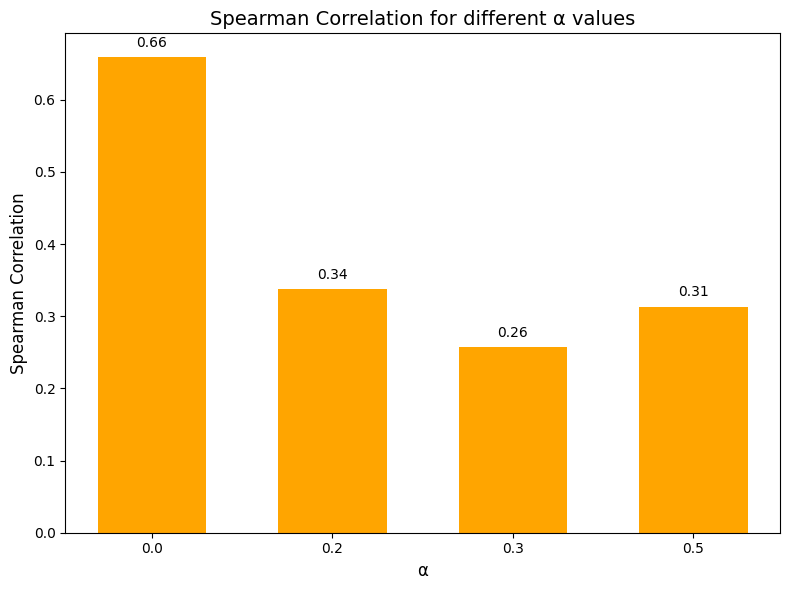

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Données
alphas = [0, 0.2, 0.3, 0.5]  # Valeurs de alpha
performances = [perf[perf.columns[0]].values[2],
                perf[perf.columns[1]].values[2],
                perf[perf.columns[2]].values[2],
                perf[perf.columns[3]].values[2]]  # Performances associées

# Création de la figure
fig, ax = plt.subplots(figsize=(8, 6))

# Création des barres
x = np.arange(len(alphas))  # Indices pour les barres
ax.bar(x, performances, color='orange', width=0.6)

# Ajout des labels et des titres
ax.set_xticks(x)
ax.set_xticklabels([f"{alpha:.1f}" for alpha in alphas])  # Affichage des valeurs de alpha
ax.set_xlabel('α', fontsize=12)
ax.set_ylabel('Spearman Correlation', fontsize=12)
ax.set_title('Spearman Correlation for different α values', fontsize=14)

# Affichage des valeurs au-dessus des barres
for i, val in enumerate(performances):
    ax.text(i, val + 0.01, f'{val:.2f}', ha='center', va='bottom', fontsize=10)

# Affichage du graphique
plt.tight_layout()
plt.show()

## Double-column histograms

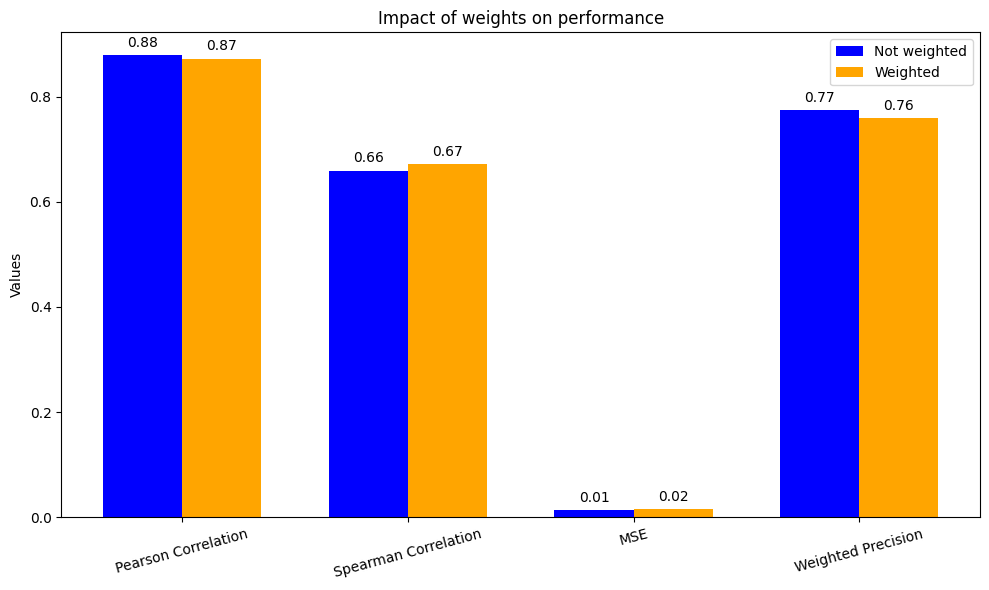

In [ ]:
# import matplotlib.pyplot as plt
# import numpy as np

# # Données : Spearman et Pearson, non ajusté et ajusté
# spearman = [perf[perf.columns[0]].values[2], perf[perf.columns[0]].values[3]]  # [non ajusté, ajusté]
# pearson = [perf2[perf2.columns[0]].values[2], perf2[perf2.columns[0]].values[3]]  # [non ajusté, ajusté]
# mse = [perf3[perf3.columns[0]].values[2], perf3[perf3.columns[0]].values[3]]  # [non ajusté, ajusté]
# wp = [perf4[perf4.columns[0]].values[2], perf4[perf4.columns[0]].values[3]]  # [non ajusté, ajusté]

# # Noms des métriques et catégories
# metrics = ['Pearson Correlation', 'Spearman Correlation', "MSE", "Weighted Precision"]
# categories = ['Not weighted', 'Weighted']
# colors = ['blue', 'orange']

# # Organisation des données
# data = [pearson, spearman, mse, wp]  # Liste des valeurs pour chaque métrique
# x = np.arange(len(metrics))  # Position des groupes sur l'axe x
# width = 0.35  # Largeur des barres

# # Création de la figure et des barres
# fig, ax = plt.subplots(figsize=(10, 6))

# # Barres non ajustées
# ax.bar(x - width/2, [d[0] for d in data], width, label=categories[0], color=colors[0])

# # Barres ajustées
# ax.bar(x + width/2, [d[1] for d in data], width, label=categories[1], color=colors[1])

# # Ajout des labels, titre et légende
# ax.set_xticks(x)
# ax.set_xticklabels(metrics, rotation=15)  # Rotation des labels si nécessaire
# ax.set_ylabel('Values')
# ax.set_title('Impact of weights on performance')
# ax.legend()

# # Affichage des valeurs sur les barres
# for i, group in enumerate(data):
#     for j, val in enumerate(group):
#         xpos = x[i] - width/2 + j * width
#         ax.text(xpos, val + 0.01, f'{val:.2f}', ha='center', va='bottom', fontsize=10)

# # Affichage
# plt.tight_layout()
# plt.show()

# Tests on loss

In [ ]:
# from module.loss import weighted_l1_loss, weighted_l2_loss, weighted_kl_divergence

# def loss_comb(outputs, true_proportions, weights=None, agg="proba", divergence="l1", reduction="mean", alpha=0):
#     """
#     Computes the loss of the model.

#     Args:
#         outputs: The output of the model
#         true_proportions: The true proportions of the classes
#         weights: The weights of the classes. If None, the weights are set to 1.
#         agg: The aggregation method of the output. Can be "proba" or "onehot".
#         divergence: The divergence to use. Can be "l1", "l2" or "kl".
#         reduction: The reduction method of the loss. Can be "mean" or "sum".
#         alpha: The weight of the max probability loss. If not 0, we recommend a very low 
#                 value (~... for l1 and l2, ~... for kl). It also depends on 'weights'.
#     """

#     if weights is None:
#         weights = torch.ones_like(true_proportions)
#         # print("Weights : ", weights)

#     max_prob_loss = -torch.mean(torch.log(outputs.max(dim=1)[0]))
#     # print("Max prob loss : ", max_prob_loss)

#     if agg == "proba":
#         pred_proportions = outputs.mean(dim=0)
#     elif agg == "onehot":
#         predicted_classes = torch.argmax(outputs, dim=1)
#         one_hot_preds = torch.nn.functional.one_hot(predicted_classes, num_classes=outputs.size(1))
#         pred_proportions = one_hot_preds.float().sum(dim=0) / outputs.size(0)
#     else:
#         raise ValueError(f"Invalid aggregation method: {agg}. Use 'proba' or 'onehot'.")

#     # print("Pred proportions : ", pred_proportions)

#     if divergence == "l1":
#         divergence_loss = weighted_l1_loss(pred_proportions, true_proportions, weights, reduction=reduction)
#     elif divergence == "mse":
#         divergence_loss = weighted_l2_loss(pred_proportions, true_proportions, weights, reduction=reduction)
#     elif divergence == "kl":
#         divergence_loss = weighted_kl_divergence(pred_proportions, true_proportions, weights, reduction=reduction)
#     else:
#         raise ValueError(f"Invalid divergence type: {divergence}. Use 'l1', 'mse', or 'kl'.")
    
#     # print("Divergence loss : ", divergence_loss)

#     loss = alpha * max_prob_loss + (1 - alpha) * divergence_loss

#     return loss

In [ ]:
# global_proportions = proportions.mean(axis=0).values
# weights = 1.0 / global_proportions
# weights /= weights.sum()
# weights = torch.tensor(weights)

In [ ]:
# proportions["dendritic cell"].idxmax()

'GACCAGATAGCAGGCA-1'

In [ ]:
# output_0 = torch.tensor([[0, 0, 0, 0, 0, 0.01, 0, 0.99, 0], 
#                          [0, 0, 0, 0, 0, 0.01, 0, 0.99, 0],
#                          [0, 0, 0, 0, 0, 0.01, 0, 0.99, 0],
#                          [0, 0, 0, 0, 0, 0.01, 0, 0.99, 0],
#                          [0, 0, 0, 0, 0, 0.01, 0, 0.99, 0],
#                          [0, 0, 0, 0, 0, 0.01, 0, 0.99, 0]])

# output_1 = torch.tensor([[0.1, 0.2, 0, 0, 0, 0.05, 0, 0.65, 0], 
#                          [0.1, 0.2, 0, 0, 0, 0.05, 0, 0.65, 0],
#                          [0.1, 0.2, 0, 0, 0, 0.05, 0, 0.65, 0],
#                          [0.1, 0.2, 0, 0, 0, 0.05, 0, 0.65, 0],
#                          [0.1, 0.2, 0, 0, 0, 0.05, 0, 0.65, 0],
#                          [0.1, 0.2, 0, 0, 0, 0.05, 0, 0.65, 0]])

# output_2 = torch.tensor([[0.2, 0.3, 0, 0, 0.05, 0.02, 0, 0.43, 0], 
#                          [0.2, 0.3, 0, 0, 0.05, 0.02, 0, 0.43, 0],
#                          [0.2, 0.3, 0, 0, 0.05, 0.02, 0, 0.43, 0],
#                          [0.2, 0.3, 0, 0, 0.05, 0.02, 0, 0.43, 0],
#                          [0.2, 0.3, 0, 0, 0.05, 0.02, 0, 0.43, 0],
#                          [0.2, 0.3, 0, 0, 0.05, 0.02, 0, 0.43, 0]])

# output_3 = torch.tensor([[0.35, 0.5728, 0, 0, 0.05, 0, 0, 0.0272, 0], 
#                          [0.35, 0.5728, 0, 0, 0.05, 0, 0, 0.0272, 0],
#                          [0.35, 0.5728, 0, 0, 0.05, 0, 0, 0.0272, 0],
#                          [0.35, 0.5728, 0, 0, 0.05, 0, 0, 0.0272, 0],
#                          [0.35, 0.5728, 0, 0, 0.05, 0, 0, 0.0272, 0],
#                          [0.35, 0.5728, 0, 0, 0.05, 0, 0, 0.0272, 0]])

# output_4 = torch.tensor([[0.2, 0.45, 0.005, 0.01, 0.1, 0.06, 0.05, 0.125, 0], 
#                          [0.2, 0.45, 0.005, 0.01, 0.1, 0.06, 0.05, 0.125, 0],
#                          [0.2, 0.45, 0.005, 0.01, 0.1, 0.06, 0.05, 0.125, 0],
#                          [0.2, 0.45, 0.005, 0.01, 0.1, 0.06, 0.05, 0.125, 0],
#                          [0.2, 0.45, 0.005, 0.01, 0.1, 0.06, 0.05, 0.125, 0],
#                          [0.2, 0.45, 0.005, 0.01, 0.1, 0.06, 0.05, 0.125, 0]])

# output_0 = torch.where(output_0 == 0, 0.00001, output_0)
# output_1 = torch.where(output_1 == 0, 0.00001, output_1)
# output_2 = torch.where(output_2 == 0, 0.00001, output_2)
# output_3 = torch.where(output_3 == 0, 0.00001, output_3)
# output_4 = torch.where(output_4 == 0, 0.00001, output_4)

In [ ]:
# pred_proportions = output_0.mean(dim=0)
# pred_proportions

tensor([1.0000e-05, 1.0000e-05, 1.0000e-05, 1.0000e-05, 1.0000e-05, 1.0000e-02,
        1.0000e-05, 9.9000e-01, 1.0000e-05])

In [ ]:
# true_proportions = torch.tensor(proportions.loc["GACCAGATAGCAGGCA-1"].values)
# true_proportions

tensor([0.2265, 0.4667, 0.0086, 0.0099, 0.1077, 0.0747, 0.0236, 0.0273, 0.0550],
       dtype=torch.float64)

In [ ]:
# for w in [None, weights]:
#     for agg in ["proba", "onehot"]:
#         for div in ["l1", "mse", "kl"]:
#             for red in ["mean", "sum"]:
#                     print(w is not None, agg, div, red)
#                     for pred_vec in [output_0, output_1, output_2, output_3, output_4]:
#                         print(f"{float(loss_comb(pred_vec, true_proportions, weights=w, agg=agg, divergence=div, reduction=red)):.3f}")
#                         print(f"proba max: {float(-torch.mean(torch.log(pred_vec.max(dim=1)[0]))):.3f}")

In [ ]:
# divergence_loss = weighted_kl_divergence(pred_proportions, true_proportions, weights)
# divergence_loss

tensor(0.0008, dtype=torch.float64)

In [ ]:
# def weighted_kl_divergence(p, q, weights, reduction="sum"):
#     p = p.clamp(min=1e-10)
#     q = q.clamp(min=1e-10)

#     loss = p * torch.log(p / q) - p + q
#     w_loss = weights * loss

#     if reduction == "mean":
#         return w_loss.mean()
#     elif reduction == "sum":
#         return w_loss.sum()
#     else:
#         raise ValueError(f"Invalid reduction mode: {reduction}. Use 'mean' or 'sum'.")


# def shannon_entropy(U):
#     return -(U * torch.log(U + 1e-12)).sum()

# def ROT(F, z, alpha=0.5, epsilon=1, n_iter=75, weights=None, reduction="sum"):
#     """
#     Compute a differentiable approximation to f_relax-ent using Algorithm 1.

#     Args:
#         F (torch.Tensor): Tensor of shape (n, k) representing the predicted probability distributions.
#         z (torch.Tensor): Tensor of shape (k,) representing the target distribution.
#         alpha (float): Smoothing parameter in [0, 1].
#         epsilon (float): Entropy parameter, must be > 0.
#         n_iter (int): Number of Sinkhorn iterations.

#     Returns:
#         torch.Tensor: The differentiable approximation to f_relax-ent(F, z).
#     """
#     n, _ = F.shape
#     # Step 1: Initialize variables
#     K = F.pow(1 / epsilon)
#     K = K.t()

#     tau = (1 + alpha * epsilon / (1 - alpha)) ** -1

#     b = torch.ones(n, device=F.device)

#     # Steps 2-3: Perform Sinkhorn iterations
#     for _ in range(n_iter):
#         # Update a
#         a = ((n * z / (K @ b)).pow(tau))
#         print(a.dtype)
#         # Update b
#         b = (torch.ones(n, device=F.device) / (K.t() @ a))

#     # Step 6: Compute U
#     U = torch.diag(a) @ K @ torch.diag(b)

#     # Step 7: Compute the final approximation to f_relax-ent
#     trace_logF_U = torch.trace(torch.log(F) @ U)
#     entropy_U = shannon_entropy(U)
#     kld = weighted_kl_divergence(U @ torch.ones(n, device=F.device) / n, z, weights=weights, reduction=reduction)

#     # Compute the final differentiable approximation
#     return (alpha / n) * (-trace_logF_U - epsilon * entropy_U) + (1 - alpha) * kld

In [ ]:
# true_proportions

In [ ]:
# ROT(output_0, true_proportions, alpha=0.5, epsilon=1, n_iter=75, weights=torch.ones(9), reduction="sum")

# For extracting some metrics

In [ ]:
# import os
# import itertools
# from tools.analysis import evaluate_spot_predictions, get_predicted_proportions
# import pandas as pd

# def aggregate_metrics(metrics_list):
#     """Calculate the mean for each metric across multiple runs."""
#     mean_metrics = pd.DataFrame(metrics_list).mean().to_dict()
#     return mean_metrics

# output_dir = "../out/rot"
# alphas = [0.3]
# learning_rates = [1e-5]
# weights_options = [True, False]
# seeds = [42, 43, 44, 45, 46, 47]

# results_best = []
# results_best_adj = []
# results_final = []
# results_final_adj = []
# combinations = list(itertools.product(alphas, learning_rates, weights_options))

# for alpha, lr, weights in combinations:
#     metrics_best_list = []
#     metrics_best_adj_list = []
#     metrics_final_list = []
#     metrics_final_adj_list = []

#     for seed in range(42, 48):
#         info_path = os.path.join(
#             output_dir,
#             f"alpha_{alpha}_lr_{lr}_weights_{weights}_divergence_rot_seed_{seed}",
#             "info.pickle",
#         )
#         if os.path.exists(info_path):
#             print("Seed ", seed, " exists")
#             with open(info_path, "rb") as f:
#                 info = pickle.load(f)

#             spot_dict = info["spot_dict"]
#             true_proportions = info["proportions"]
#             pred_best = info["pred_best"]
#             pred_best_adj = info["pred_best_adjusted"]

#             is_final = True
#             try:
#                 pred_final = info["pred_final"]
#                 pred_final_adj = info["pred_final_adjusted"]
#             except Exception:
#                 is_final = False

#             # Load true and predicted proportions
#             predicted_best_proportions = get_predicted_proportions(pred_best, spot_dict)
#             predicted_best_proportions_adj = get_predicted_proportions(pred_best_adj, spot_dict)

#             if is_final:
#                 predicted_final_proportions = get_predicted_proportions(pred_final, spot_dict)
#                 predicted_final_proportions_adj = get_predicted_proportions(pred_final_adj, spot_dict)

#             # Evaluate the metrics
#             metrics_best = evaluate_spot_predictions(true_proportions, predicted_best_proportions)
#             metrics_best_adj = evaluate_spot_predictions(true_proportions, predicted_best_proportions_adj)

#             if is_final:
#                 metrics_final = evaluate_spot_predictions(true_proportions, predicted_final_proportions)
#                 metrics_final_adj = evaluate_spot_predictions(true_proportions, predicted_final_proportions_adj)

#             metrics_best_list.append(metrics_best)
#             metrics_best_adj_list.append(metrics_best_adj)

#             if is_final:
#                 metrics_final_list.append(metrics_final)
#                 metrics_final_adj_list.append(metrics_final_adj)

#     mean_metrics_best = aggregate_metrics(metrics_best_list)
#     mean_metrics_best_adj = aggregate_metrics(metrics_best_adj_list)
#     mean_metrics_final = aggregate_metrics(metrics_final_list)
#     mean_metrics_final_adj = aggregate_metrics(metrics_final_adj_list)

#     result_best = {"alpha": alpha, "lr": lr, "weights": weights, "divergence": "rot", **mean_metrics_best}
#     result_best_adj = {
#         "alpha": alpha,
#         "lr": lr,
#         "weights": weights,
#         "divergence": "rot",
#         **mean_metrics_best_adj,
#     }
#     result_final = {"alpha": alpha, "lr": lr, "weights": weights, "divergence": "rot", **mean_metrics_final}
#     result_final_adj = {
#         "alpha": alpha,
#         "lr": lr,
#         "weights": weights,
#         "divergence": "rot",
#         **mean_metrics_final_adj,
#     }

#     results_best.append(result_best)
#     results_best_adj.append(result_best_adj)
#     results_final.append(result_final)
#     results_final_adj.append(result_final_adj)

# # Save final results
# results_df_best = pd.DataFrame(results_best)
# results_df_best_adj = pd.DataFrame(results_best_adj)
# results_df_final = pd.DataFrame(results_final)
# results_df_final_adj = pd.DataFrame(results_final_adj)

# results_df_best.to_csv(os.path.join(output_dir, f"summary_metrics_rot_best.csv"), index=False)
# results_df_best_adj.to_csv(os.path.join(output_dir, f"summary_metrics_rot_best_adj.csv"), index=False)
# results_df_final.to_csv(os.path.join(output_dir, f"summary_metrics_rot_final.csv"), index=False)
# results_df_final_adj.to_csv(os.path.join(output_dir, f"summary_metrics_rot_final_adj.csv"), index=False)

# Test on loaders

In [ ]:
# from module.load_data import SpotDataset, split_data

# train_spot_dict, train_proportions, val_spot_dict, val_proportions, test_spot_dict, test_proportions = split_data(
#     spot_dict, proportions, train_size=0.5, val_size=0.25, rs=42
# )

# # Create datasets
# train_dataset = SpotDataset(train_spot_dict, train_proportions, image_dict)
# val_dataset = SpotDataset(val_spot_dict, val_proportions, image_dict)
# test_dataset = SpotDataset(test_spot_dict, test_proportions, image_dict)

# # Create dataloaders
# train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=1, shuffle=True)
# val_loader = torch.utils.data.DataLoader(val_dataset, batch_size=1, shuffle=False)
# test_loader = torch.utils.data.DataLoader(test_dataset, batch_size=1, shuffle=False)